In [2]:
%pylab notebook

Populating the interactive namespace from numpy and matplotlib


Light, Spectra:
 * Frequency spectra of light of typical colors. THz
 * Sampling: sample 10x faster than highest frequency even if only 2x is strictly required
 * Cosines and their two-sided Fourier transforms
 * Power spectrum as the one-sided magnitude square
 * Example of sum of two Cosines
 * White light as totally random Gaussian draws and its spectrum
 * Realistic filterd light specta and its IFFT time plots
 * Parsival's Theorem that total power is the same in time or frequency

In [ ]:
c = 299792458  # m/s
capprox = 3e8  # m/s
lam = np.array([400e-9, 500e-9, 600e-9, 800e-9])  # m
f = capprox/lam
f  # visible light is in a narrow band between 1/10 amd 1 petahertz (10^15 Hz)

In [ ]:
f/1e12  # THz

In [ ]:
2*pi*f/1e12  # THz

In [ ]:
T = 1e-12 # 1ps
T = 200e-15 # 200fs
t = np.linspace(0,T,num=1e4+1)
dt = np.mean(diff(t))  # sample spacing
figure(figsize=(9.5,5))
Efield = cos(2*pi*750e12*t)
plot(t,Efield, alpha=0.5)

In [ ]:
freq = fft.fftfreq(len(t),dt)
figure(figsize=(9.5,4))
plot(freq)
xlabel('index in array')
ylabel('frequency component at that index [Hz]')
title('fftfreq return values.\nNote that positive frequencies come first, then negative ones.')

In [ ]:
freq = fft.fftfreq(len(t),dt)
Efft = fft.fft(Efield)
figure(figsize=(9.5,4))
plot(freq,abs(Efft)**2)
ylabel('Power = $|E|^2$  [arbitrary units]')
xlabel('Frequency [Hz]. Note max frequency shown is $1/(2T_{sample})$ because of sampling.')
title('Two-sided spectrum is symmetric around 0 becuase 2cos is $e^{+iωt} + e^{-iωt}$');

In [ ]:
dt

In [ ]:
fcenter = 750e12
deltaf = 10e12
f1 = fcenter - deltaf
f2 = fcenter + deltaf
figure(figsize=(9.5,5))
Efield1 = cos(2*pi*f1*t)
Efield2 = cos(2*pi*f2*t)
plot(t,Efield1, alpha=0.5)
plot(t,Efield2, alpha=0.5)
plot(t,Efield1+Efield2, alpha=0.5)
#xlim(0,10e-14)

In [ ]:
#tau = linspace(-1e-13,1e13,num=501)
tau = t
(T,TAU) = meshgrid(t,tau)
Esum = cos(2*pi*f1*T) + cos(2*pi*f2*T) + cos(2*pi*f1*(T+TAU)) + cos(2*pi*f2*(T+TAU))

In [ ]:
#figure(figsize=(9.5,9.5))
#imshow(Esum)

In [ ]:
figure(figsize=(9.5,5))
plot(t,Esum[3], alpha=0.5)

In [ ]:
figure(figsize=(9.5,5))
interference = mean(Esum**2,axis=1)
plot(tau, interference, alpha=0.5)

In [ ]:
1/5e-14, 2*deltaf

In [ ]:
dtau = mean(diff(tau))
freq = fft.fftfreq(len(tau),dt)
Ifft = fft.fft(interference)
figure(figsize=(9.5,4))
plot(freq,abs(Ifft)**2)
ylabel('Power = $|I(\tau)|^2$  [arbitrary units]')
xlabel('Frequency [Hz]. Note max frequency shown is $1/(2T_{sample})$ because of sampling.')
title('Two-sided spectrum is symmetric around 0 becuase 2cos is $e^{+iωt} + e^{-iωt}$');

In [ ]:
'%e %e'%(f1,f2)

In [ ]:
1/(4/589.0e-9 - 4/589.6e-9)

## Band-Limited Noise

In [3]:
N=2**16
dt = 1e-3
t = arange(N)*dt
E = randn(N)

<IPython.core.display.Javascript object>


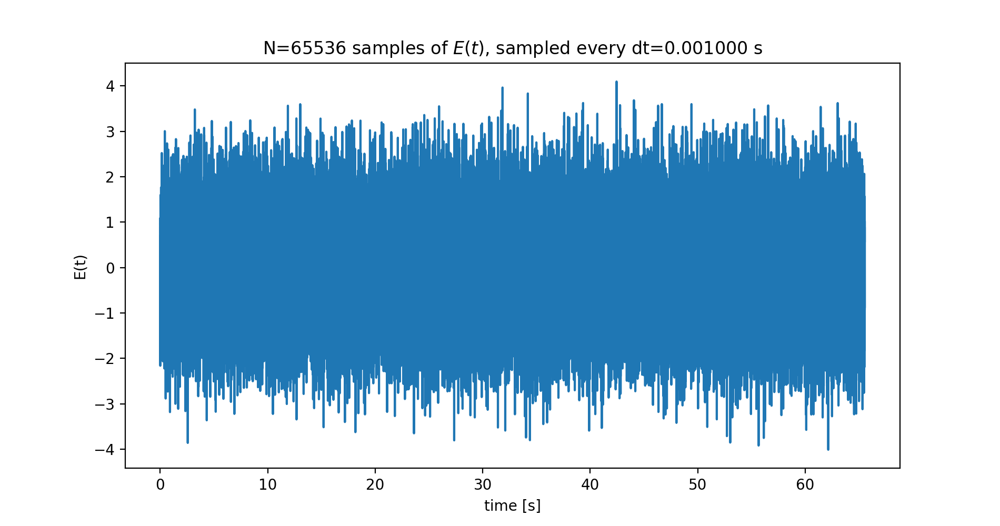

In [4]:
figure(figsize=(9.5,5))
plot(t, E)
xlabel('time [s]')
ylabel('E(t)')
title('N=%d samples of $E(t)$, sampled every dt=%f s'%(N,dt));

<IPython.core.display.Javascript object>


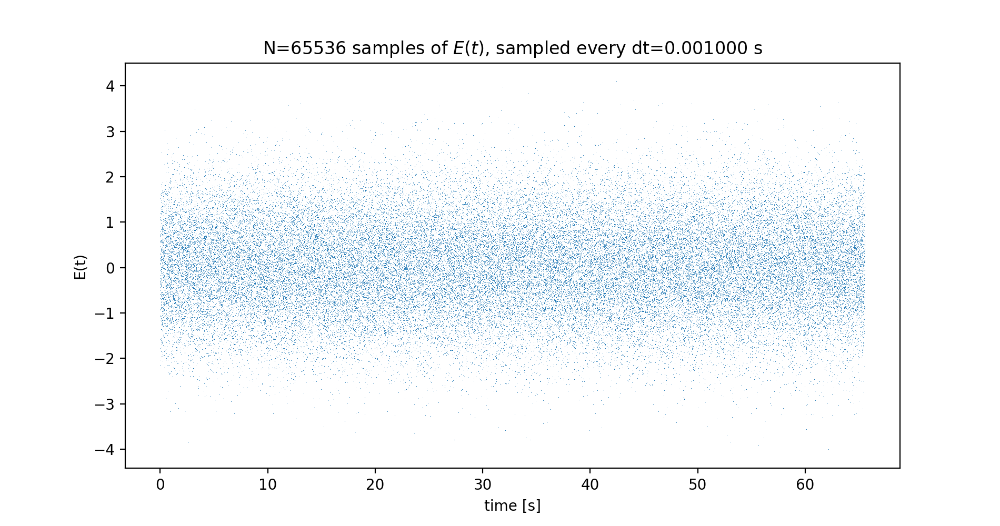

In [5]:
figure(figsize=(9.5,5))
plot(t, E, ',')
xlabel('time [s]')
ylabel('E(t)')
title('N=%d samples of $E(t)$, sampled every dt=%f s'%(N,dt));

<IPython.core.display.Javascript object>


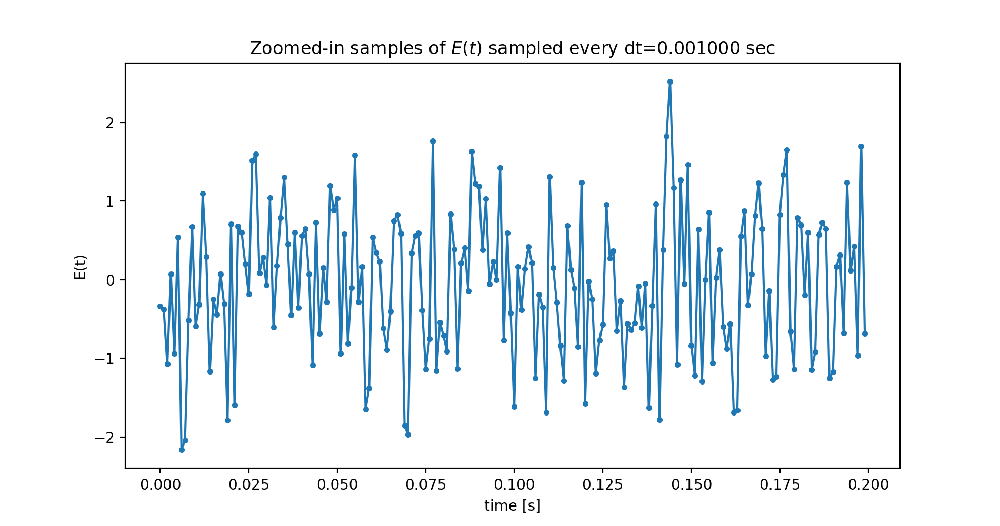

In [6]:
figure(figsize=(9.5,5))
plot(t[:200], E[:200], '.-')
xlabel('time [s]')
ylabel('E(t)')
title('Zoomed-in samples of $E(t)$ sampled every dt=%f sec'%(dt));

In [7]:
Efft = fft.fft(E)
Efft

array([-80.72735976  +0.j        , 239.44994317+112.37311762j,
       317.17306602-112.09997667j, ..., -89.45255053+116.07381397j,
       317.17306602+112.09997667j, 239.44994317-112.37311762j])

In [8]:
freq = fft.fftfreq(len(E), dt)
freq

array([ 0.        ,  0.01525879,  0.03051758, ..., -0.04577637,
       -0.03051758, -0.01525879])

<IPython.core.display.Javascript object>


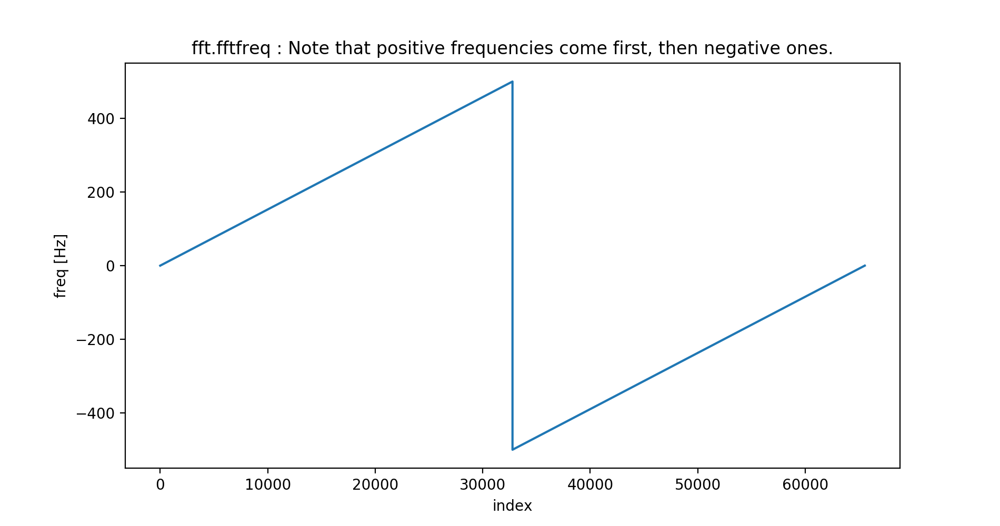

In [9]:
figure(figsize=(9.5,5))
plot(freq)
xlabel('index')
ylabel('freq [Hz]')
title('fft.fftfreq : Note that positive frequencies come first, then negative ones.');

<IPython.core.display.Javascript object>


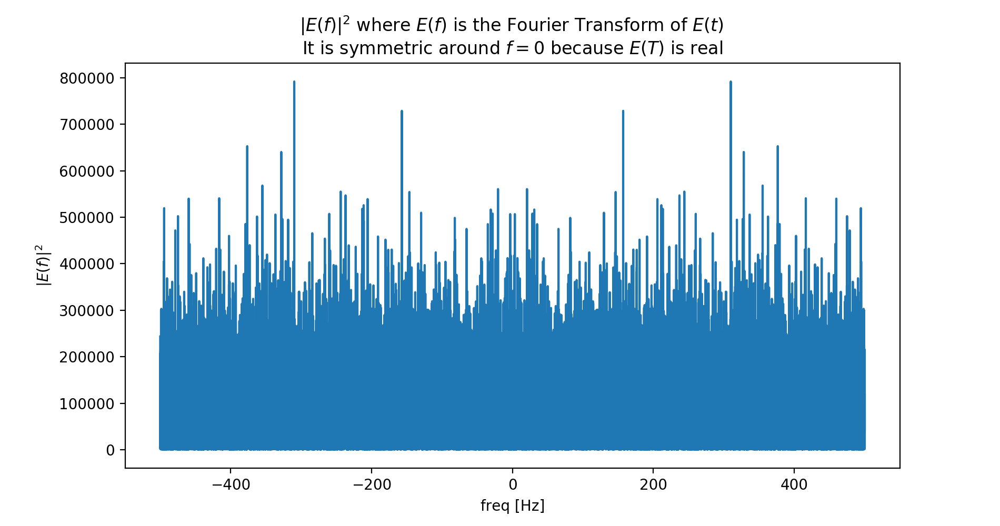

In [10]:
figure(figsize=(9.5,5))
plot(freq, abs(Efft)**2)
xlabel('freq [Hz]')
ylabel('$|E(f)|^2$')
title('$|E(f)|^2$ where $E(f)$ is the Fourier Transform of $E(t)$ \n'+
      'It is symmetric around $f=0$ because $E(T)$ is real');

<IPython.core.display.Javascript object>


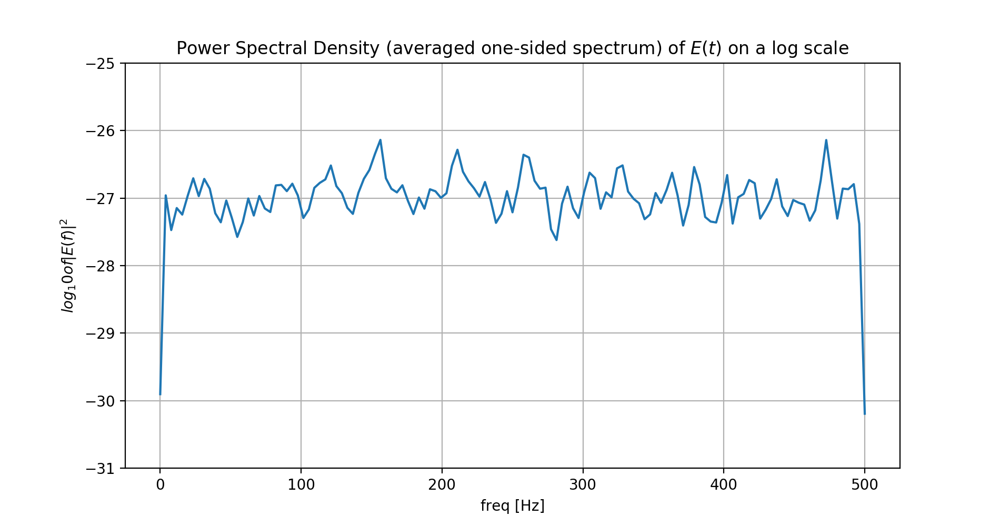

In [12]:
figure(figsize=(9.5,5))
psd(E, NFFT=2**8, Fs=1/dt);
xlabel('freq [Hz]')
ylabel('$log_10 of|E(f)|^2$')
title('Power Spectral Density (averaged one-sided spectrum) of $E(t)$ on a log scale');

<IPython.core.display.Javascript object>


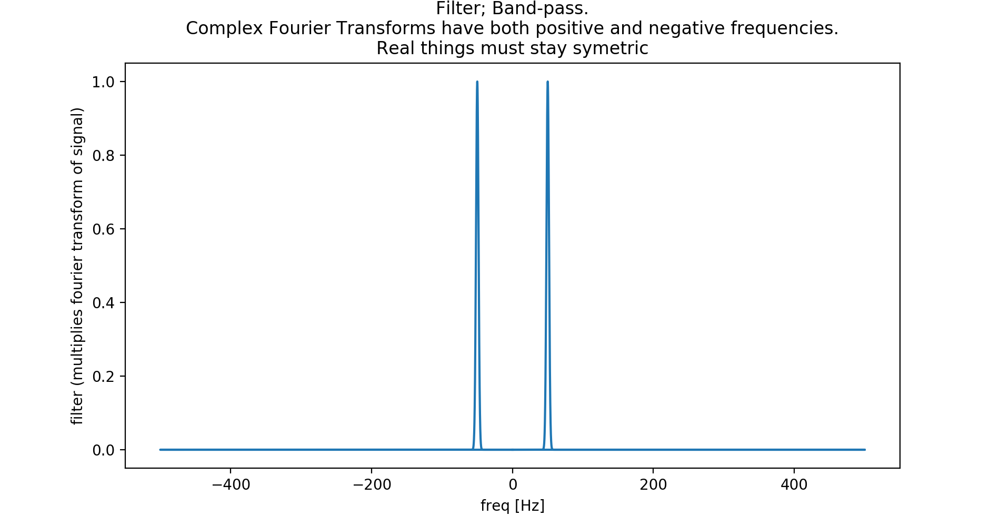

In [25]:
mu = max(freq)/10
sigma = max(freq)/200
filt = exp(-(abs(freq)-mu)**2/sigma**2)

figure(figsize=(9.5,5))
plot(freq, filt)
xlabel('freq [Hz]')
ylabel('filter (multiplies fourier transform of signal)')
title('Filter; Band-pass.\n'+
      'Complex Fourier Transforms have both positive and negative frequencies.\n'+
      'Real things must stay symetric');

In [26]:
EfftFilt = Efft * filt

<IPython.core.display.Javascript object>


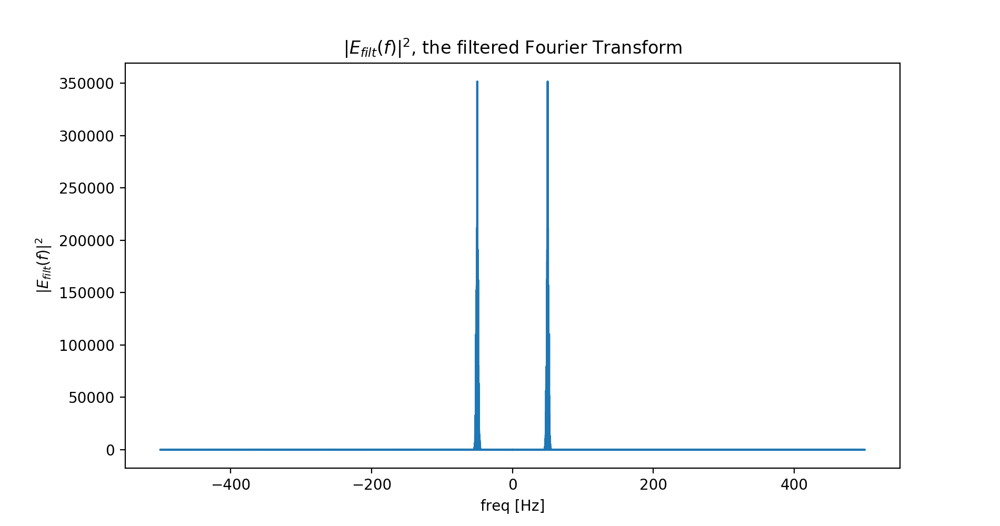

In [27]:
figure(figsize=(9.5,5))
plot(freq, abs(EfftFilt)**2)
xlabel('freq [Hz]')
ylabel('$|E_{filt}(f)|^2$')
title('$|E_{filt}(f)|^2$, the filtered Fourier Transform');

In [28]:
Efilt = fft.ifft(EfftFilt).real  # Because we've filtered symmetrically, the imaginary part is only rounding error

<IPython.core.display.Javascript object>


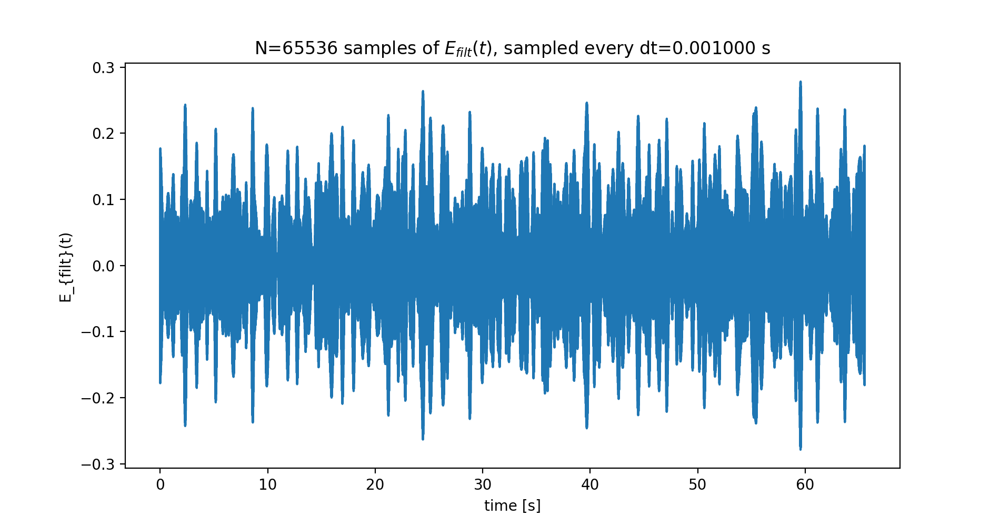

In [29]:
figure(figsize=(9.5,5))
plot(t, Efilt)
xlabel('time [s]')
ylabel('E_{filt}(t)')
title('N=%d samples of $E_{filt}(t)$, sampled every dt=%f s'%(N,dt));

<IPython.core.display.Javascript object>


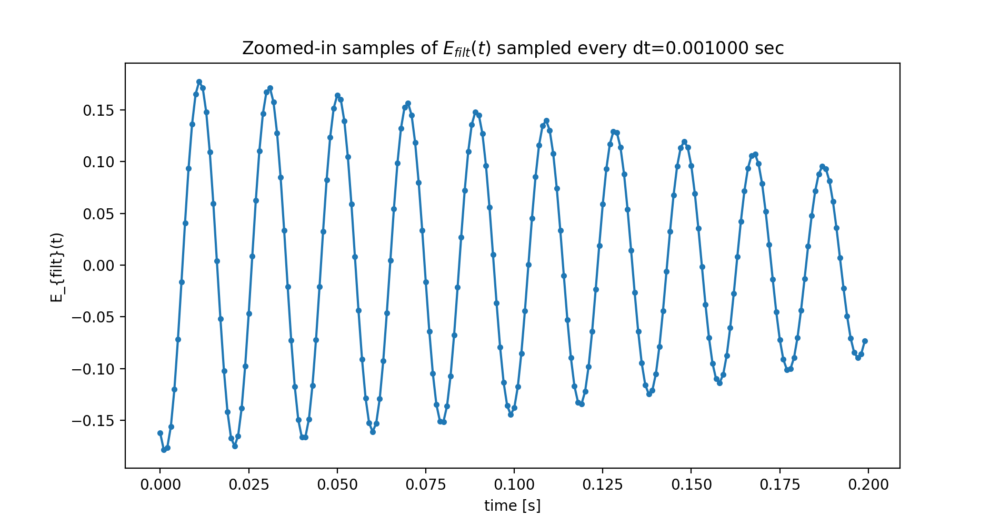

In [30]:
figure(figsize=(9.5,5))
plot(t[:200], Efilt[:200], '.-')
xlabel('time [s]')
ylabel('E_{filt}(t)')
title('Zoomed-in samples of $E_{filt}(t)$ sampled every dt=%f sec'%(dt));

<IPython.core.display.Javascript object>


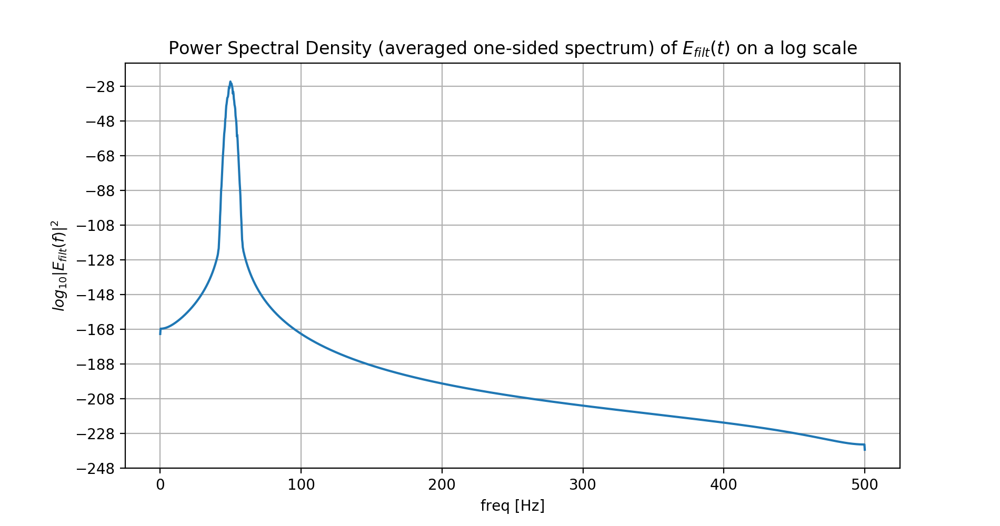

In [31]:
figure(figsize=(9.5,5))
psd(Efilt, NFFT=2**12, Fs=1/dt);
xlabel('freq [Hz]')
ylabel('$log_{10} |E_{filt}(f)|^2$')
title('Power Spectral Density (averaged one-sided spectrum) of $E_{filt}(t)$ on a log scale');

<IPython.core.display.Javascript object>


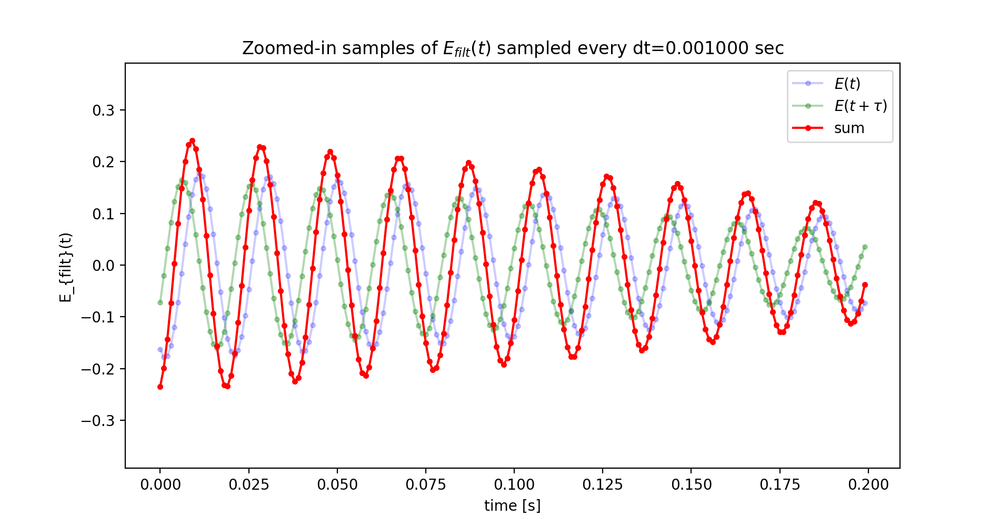

In [32]:
import matplotlib.animation


fig, ax = plt.subplots(figsize=(9.5,5))
p1, = ax.plot(t[:200], Efilt[:200], 'b.-', label='$E(t)$', alpha=0.2)
p2, = ax.plot(t[:200], Efilt[:200], 'g.-', label='$E(t + τ )$', alpha=0.3)
psum, = ax.plot(t[:200], 2*Efilt[:200], 'r.-', label='sum')
#psum, = ax.plot(t[:200], Efilt[:200], '.-', label='sum')
legend(loc='upper right')
xlabel('time [s]')
ylabel('E_{filt}(t)')
title('Zoomed-in samples of $E_{filt}(t)$ sampled every dt=%f sec'%(dt));

def animate(i):
    p2.set_data(t[:200], Efilt[i:200+i])
    psum.set_data(t[:200], Efilt[:200]+Efilt[i:200+i])

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=200)

In [22]:
from IPython.display import HTML
HTML(ani.to_jshtml())

Animation size has reached 21168457 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [33]:
intensity = []
NSHIFTS = 2**9
shifts = arange(-NSHIFTS,NSHIFTS)
for s in shifts:
    i = sum((Efilt+roll(Efilt,s))**2)/len(Efilt)
    intensity.append(i)

<IPython.core.display.Javascript object>


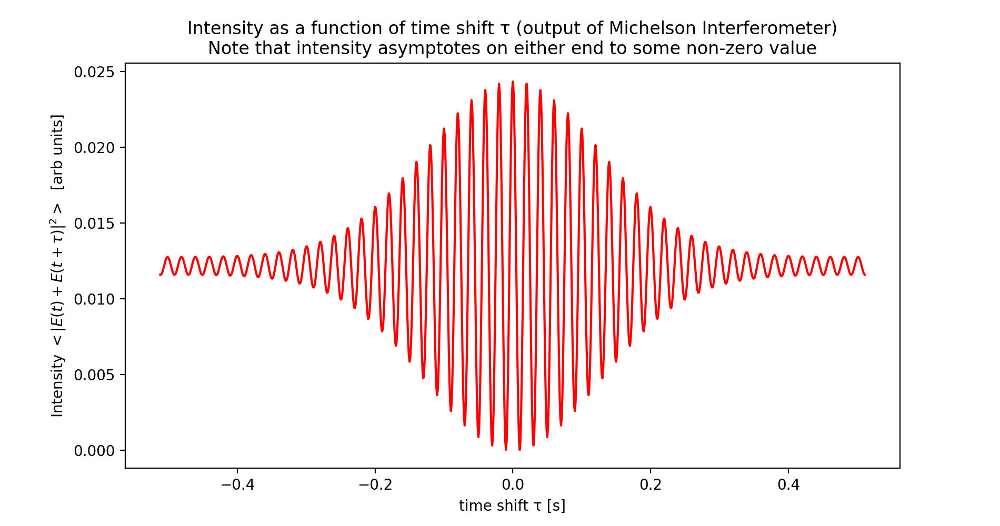

In [34]:
figure(figsize=(9.5,5))
plot(shifts*dt, intensity, 'r-')
xlabel('time shift τ [s]')
ylabel('Intensity $< |E(t) +E(t + τ )|^2>$  [arb units]')
title('Intensity as a function of time shift τ (output of Michelson Interferometer)\n'+
      'Note that intensity asymptotes on either end to some non-zero value');

In [ ]:
figure(figsize=(9.5,5))
psd(intensity, NFFT=NSHIFTS*2, Fs=1/dt, color='r');
xlabel('freq [Hz]')
ylabel('$|E_{filt}(f)|^2$')
title('Intensity Power Spectral Density on a log scale\n'+
      'Note that the spectrum matches that of $E_{filt}(t)$, with the addition of a $f=0$ constant offset term.');

## Audio

In [71]:
import IPython.display as ipd

In [94]:
sample_rate = 32000 # sample rate in samples per second (Hz)
T = 2.0    # total time in seconds
t = linspace(0, T, int(T*sample_rate), endpoint=False) # time variable
x = sin(2*pi*440*t)                # pure sine wave at 440 Hz

In [95]:
ipd.Audio(x, rate=sample_rate) # play a NumPy array. It will normalize the overall amplitude

In [103]:
n = randn(len(t))/5
ipd.Audio(x+n, rate=sample_rate)

<IPython.core.display.Javascript object>


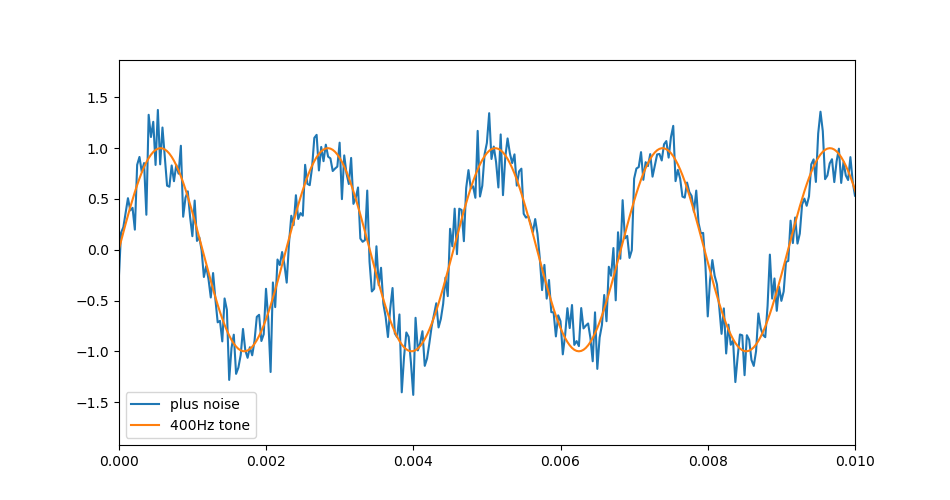

In [109]:
figure(figsize=(9.5,5))
plot(t, x+n, label='plus noise', alpha=1)
plot(t, x, label='400Hz tone' )
xlim(0, 0.01)
legend()

<IPython.core.display.Javascript object>


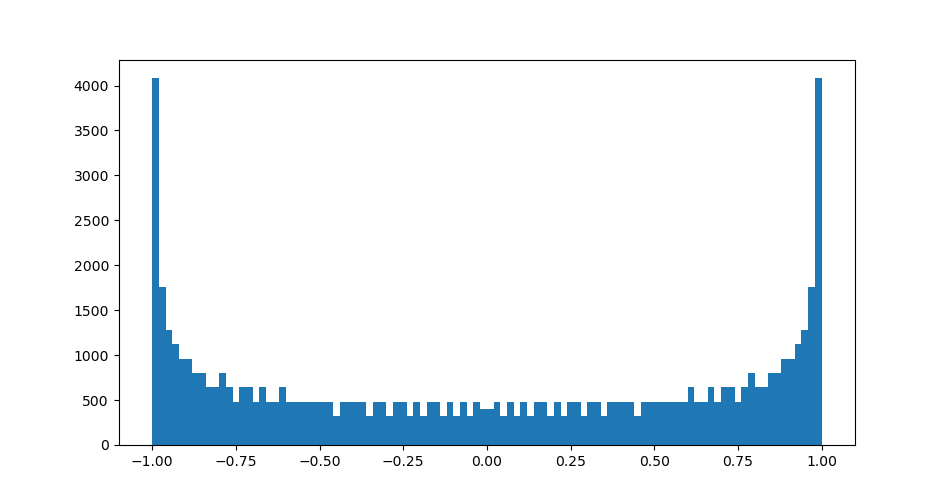

In [97]:
figure(figsize=(9.5,5))
hist(x, bins=100);

In [149]:
import scipy.io.wavfile
(sample_rate, okso) = scipy.io.wavfile.read('okso.wav')
#okso = okso/max(okso)  # fft and fft^2 are still really big
ipd.Audio(okso, rate=sample_rate)

<IPython.core.display.Javascript object>


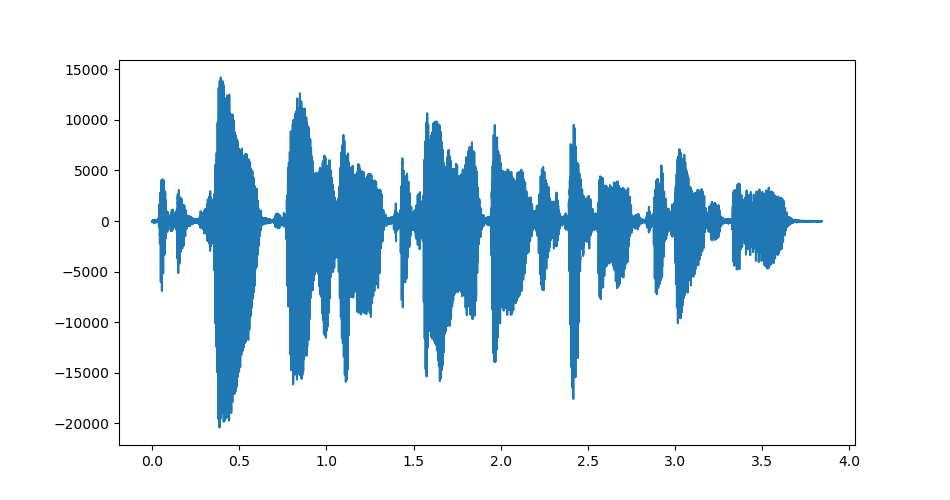

In [150]:
figure(figsize=(9.5,5))
t = arange(len(okso))/sample_rate
plot(t, okso)

In [151]:
sample_rate

32000

<IPython.core.display.Javascript object>


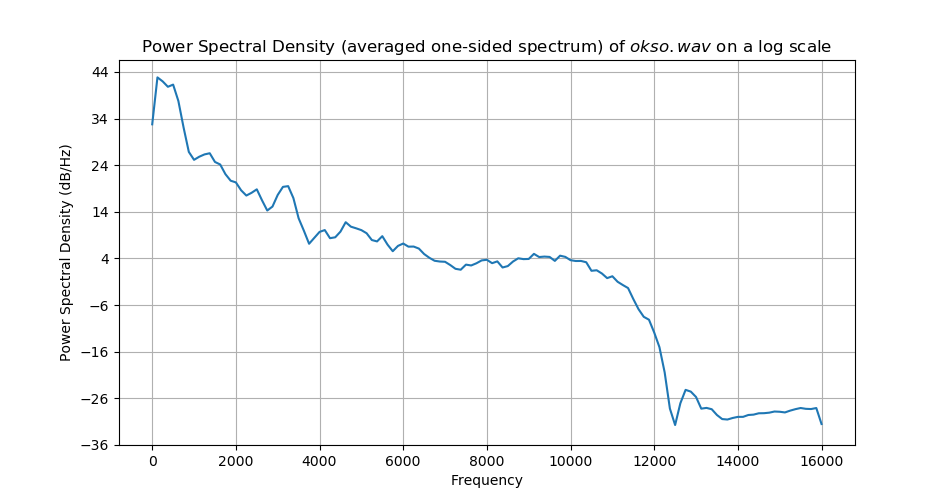

In [152]:
figure(figsize=(9.5,5))
psd(okso, Fs=sample_rate);
title('Power Spectral Density (averaged one-sided spectrum) of $okso.wav$ on a log scale');

In [153]:
oksoFFT = fft.fft(okso)
oksoFFT

array([-370682.        +9.45874490e-11j,   14047.57814306-1.06491960e+04j,
         12053.01994525+9.55090397e+03j, ...,
          1271.83577481+2.21348773e+04j,   12053.01994524-9.55090397e+03j,
         14047.57814306+1.06491960e+04j])

<IPython.core.display.Javascript object>


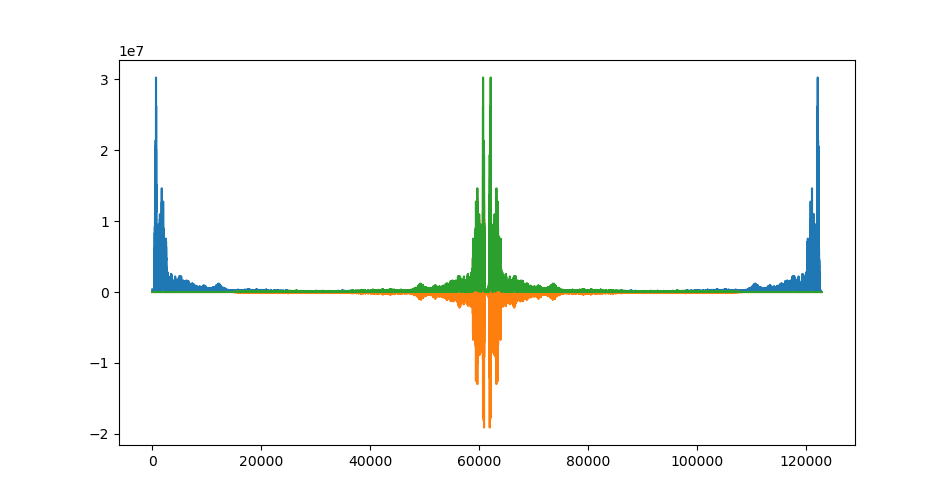

In [191]:
figure(figsize=(9.5,5))
plot(abs(oksoFFT))

In [154]:
freq = fft.fftfreq(len(okso), 1.0/sample_rate)
freq

array([ 0.        ,  0.26036793,  0.52073586, ..., -0.7811038 ,
       -0.52073586, -0.26036793])

In [155]:
max(freq)

15999.86981603378

In [156]:
freq[1], 1/max(t)

(0.2603679324345215, 0.26037005093489124)

<IPython.core.display.Javascript object>


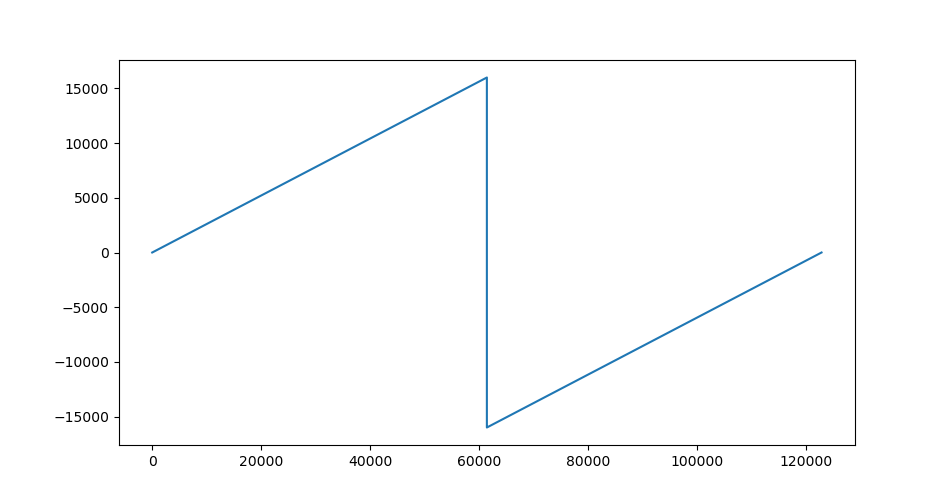

In [158]:
figure(figsize=(9.5,5))
plot(freq)

<IPython.core.display.Javascript object>


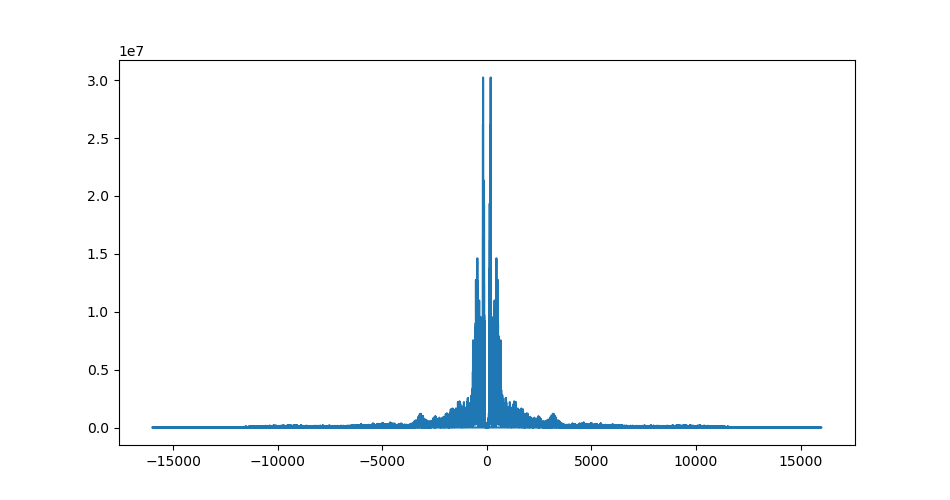

In [194]:
figure(figsize=(9.5,5))
plot(freq, abs(oksoFFT))

<IPython.core.display.Javascript object>


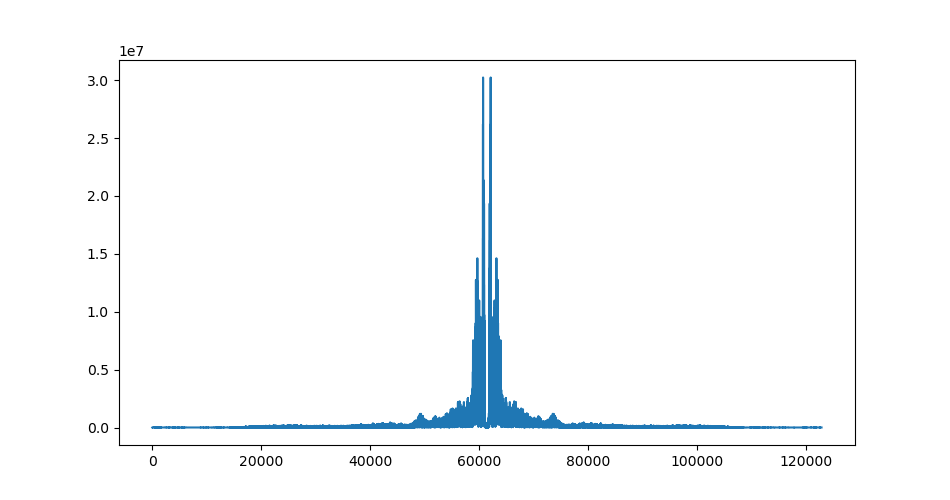

In [195]:
figure(figsize=(9.5,5))
plot(abs(fft.fftshift(oksoFFT)))

<IPython.core.display.Javascript object>


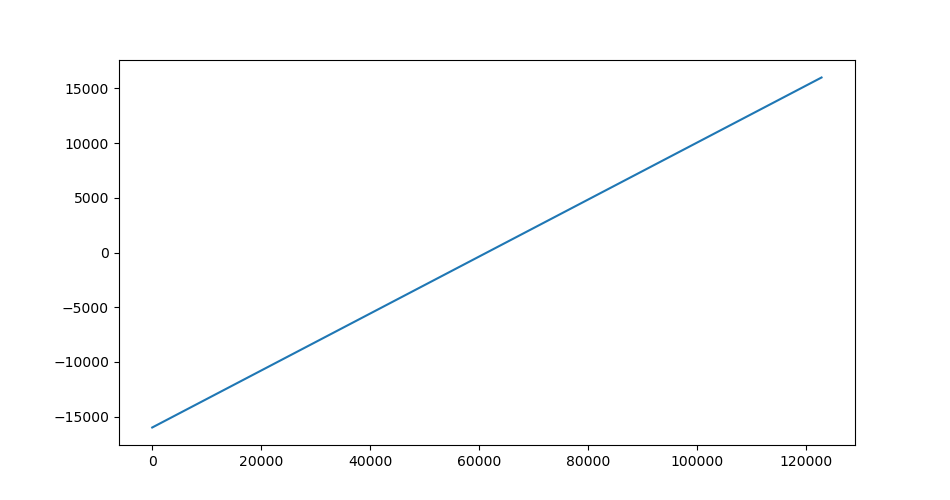

In [196]:
figure(figsize=(9.5,5))
plot(fft.fftshift(freq))

<IPython.core.display.Javascript object>


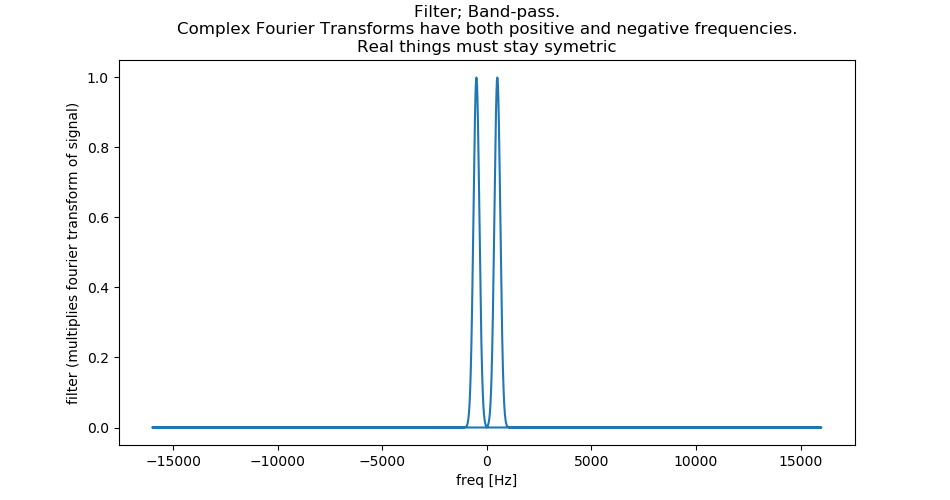

In [174]:
# Make a band-pass filter
mu = 150  # too low
mu = 500
sigma = 200
filt = exp(-(abs(freq)-mu)**2/sigma**2)

figure(figsize=(9.5,5))
plot(freq, filt)
xlabel('freq [Hz]')
ylabel('filter (multiplies fourier transform of signal)')
title('Filter; Band-pass.\n'+
      'Complex Fourier Transforms have both positive and negative frequencies.\n'+
      'Real things must stay symetric');

In [175]:
oksoFFT_filt = oksoFFT * filt

<IPython.core.display.Javascript object>


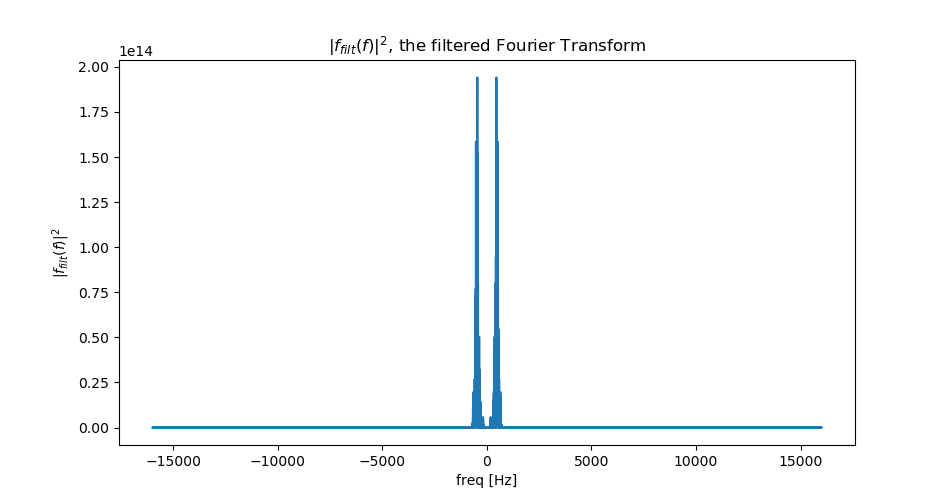

In [176]:
figure(figsize=(9.5,5))
plot(freq, abs(oksoFFT_filt)**2)
xlabel('freq [Hz]')
ylabel('$|f_{filt}(f)|^2$')
title('$|f_{filt}(f)|^2$, the filtered Fourier Transform');

In [186]:
okso_filt_complex = fft.ifft(oksoFFT_filt)
okso_filt_complex

array([2.55731813-6.25277607e-13j, 2.49141538-6.73328431e-13j,
       2.41433144-2.57086182e-13j, ..., 2.68772126-5.41311137e-13j,
       2.65541859+1.82429430e-13j, 2.61197961-4.32818671e-13j])

In [189]:
okso_filt = okso_filt_complex.real
okso_filt

array([2.55731813, 2.49141538, 2.41433144, ..., 2.68772126, 2.65541859,
       2.61197961])

<IPython.core.display.Javascript object>


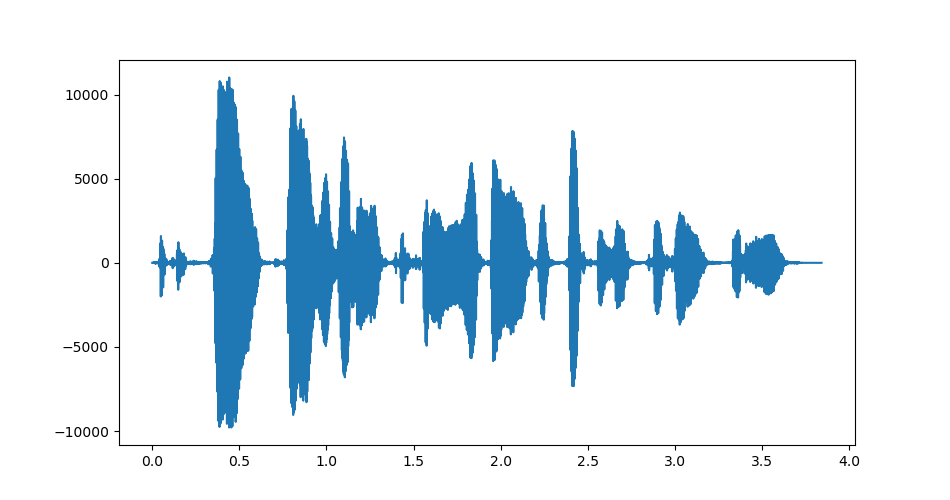

In [188]:
figure(figsize=(9.5,5))
plot(t, okso_filt)

<IPython.core.display.Javascript object>


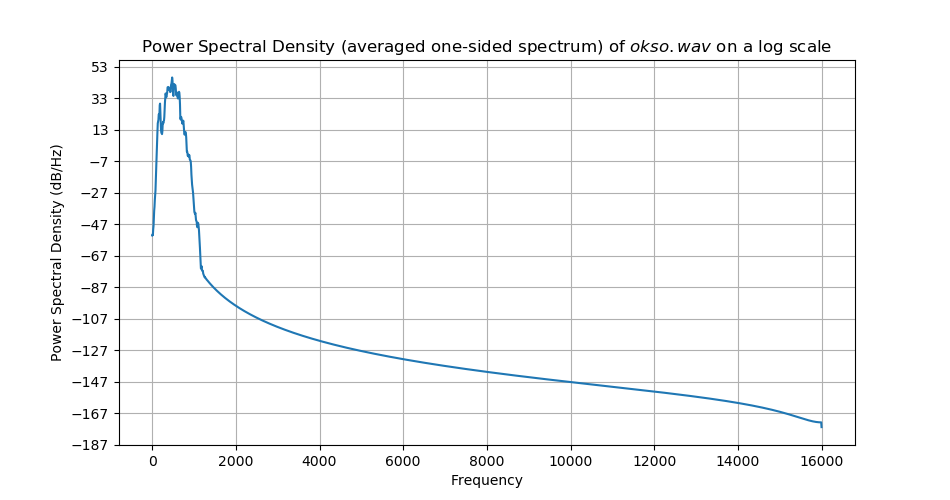

In [178]:
figure(figsize=(9.5,5))
psd(okso_filt, NFFT=2**12, Fs=sample_rate);
title('Power Spectral Density (averaged one-sided spectrum) of $okso.wav$ on a log scale');

In [179]:
ipd.Audio(okso_filt, rate=sample_rate)